## Loading packages

In [ ]:
!pip install kaggle

In [ ]:
from google.colab import files

files.upload()

In [ ]:
! mkdir ~/.kaggle

! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
! kaggle datasets list

In [ ]:
!pip install --upgrade --force-reinstall --no-deps kaggle

In [ ]:
! mkdir C

In [ ]:
! unzip cassava-leaf-disease-classification.zip -d C

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import datetime

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import tensorflow as tf
from tensorflow.keras import models, layers
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.optimizers import Adam

# ignoring warnings
import warnings
warnings.simplefilter("ignore")

import os, cv2, json
from PIL import Image

## Work directory

In [ ]:
WORK_DIR = '/content/C'
os.listdir(WORK_DIR)

['train_tfrecords',
 'sample_submission.csv',
 'test_tfrecords',
 'label_num_to_disease_map.json',
 'train_images',
 'train.csv',
 'test_images']

# First look at the data

In [ ]:
print('Train images: %d' %len(os.listdir(
    os.path.join(WORK_DIR, "train_images"))))

Train images: 21397


In [ ]:
with open(os.path.join(WORK_DIR, "label_num_to_disease_map.json")) as file:
    print(json.dumps(json.loads(file.read()), indent=4))

{
    "0": "Cassava Bacterial Blight (CBB)",
    "1": "Cassava Brown Streak Disease (CBSD)",
    "2": "Cassava Green Mottle (CGM)",
    "3": "Cassava Mosaic Disease (CMD)",
    "4": "Healthy"
}


In [ ]:
train_labels = pd.read_csv(os.path.join(WORK_DIR, "train.csv"))
train_labels.head()

,image_id,label
0,1000015157.jpg,0
1,1000201771.jpg,3
2,100042118.jpg,1
3,1000723321.jpg,1
4,1000812911.jpg,3


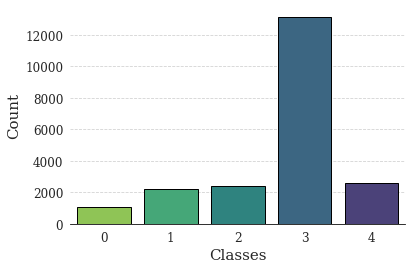

In [ ]:
sns.set_style("whitegrid")
fig, ax = plt.subplots(figsize = (6, 4))

for i in ['top', 'right', 'left']:
    ax.spines[i].set_visible(False)
ax.spines['bottom'].set_color('black')

sns.countplot(train_labels.label, edgecolor = 'black',
              palette = reversed(sns.color_palette("viridis", 5)))
plt.xlabel('Classes', fontfamily = 'serif', size = 15)
plt.ylabel('Count', fontfamily = 'serif', size = 15)
plt.xticks(fontfamily = 'serif', size = 12)
plt.yticks(fontfamily = 'serif', size = 12)
ax.grid(axis = 'y', linestyle = '--', alpha = 0.9)
plt.show()

## Some photos of "0": "Cassava Bacterial Blight (CBB)"

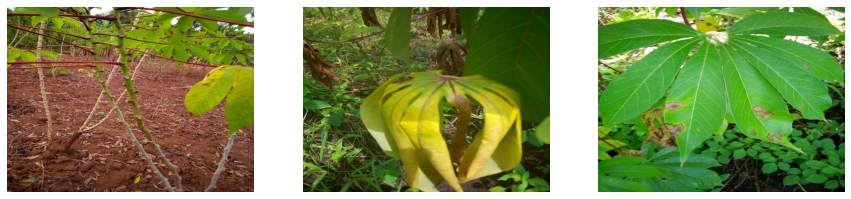

In [ ]:
sample = train_labels[train_labels.label == 0].sample(3)
plt.figure(figsize=(15, 5))
for ind, (image_id, label) in enumerate(zip(sample.image_id, sample.label)):
    plt.subplot(1, 3, ind + 1)
    img = cv2.imread(os.path.join(WORK_DIR, "train_images", image_id))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.axis("off")
    
plt.show()

## Some photos of "1": "Cassava Brown Streak Disease (CBSD)"

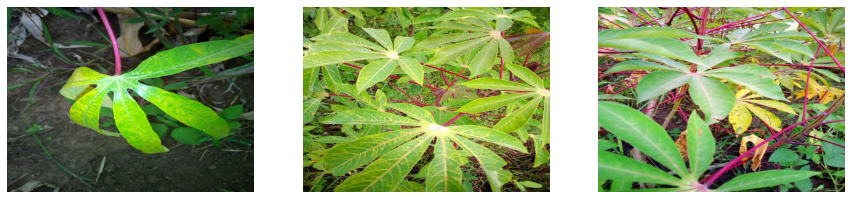

In [ ]:
sample = train_labels[train_labels.label == 1].sample(3)
plt.figure(figsize=(15, 5))
for ind, (image_id, label) in enumerate(zip(sample.image_id, sample.label)):
    plt.subplot(1, 3, ind + 1)
    img = cv2.imread(os.path.join(WORK_DIR, "train_images", image_id))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.axis("off")
    
plt.show()

## Some photos of "2": "Cassava Green Mottle (CGM)"

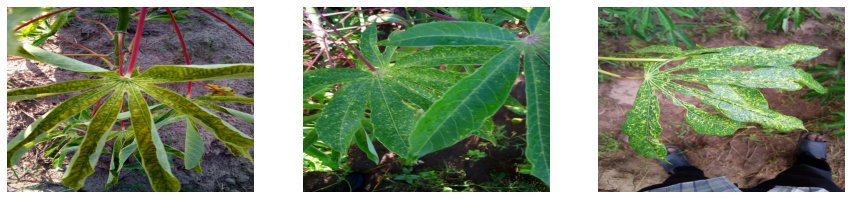

In [ ]:
sample = train_labels[train_labels.label == 2].sample(3)
plt.figure(figsize=(15, 5))
for ind, (image_id, label) in enumerate(zip(sample.image_id, sample.label)):
    plt.subplot(1, 3, ind + 1)
    img = cv2.imread(os.path.join(WORK_DIR, "train_images", image_id))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.axis("off")
    
plt.show()

## Some photos of "3": "Cassava Mosaic Disease (CMD)"

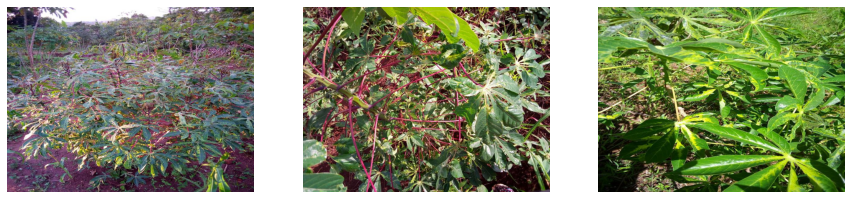

In [ ]:
sample = train_labels[train_labels.label == 3].sample(3)
plt.figure(figsize=(15, 5))
for ind, (image_id, label) in enumerate(zip(sample.image_id, sample.label)):
    plt.subplot(1, 3, ind + 1)
    img = cv2.imread(os.path.join(WORK_DIR, "train_images", image_id))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.axis("off")
    
plt.show()

## Some photos of "4": "Healthy"

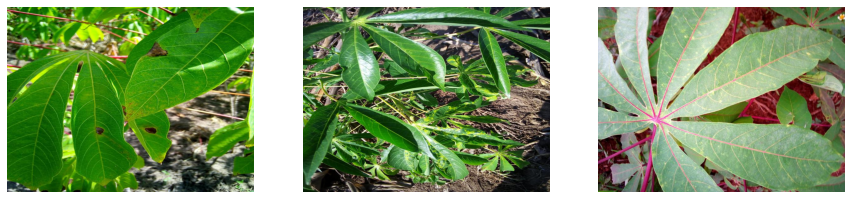

In [ ]:
sample = train_labels[train_labels.label == 4].sample(3)
plt.figure(figsize=(15, 5))
for ind, (image_id, label) in enumerate(zip(sample.image_id, sample.label)):
    plt.subplot(1, 3, ind + 1)
    img = cv2.imread(os.path.join(WORK_DIR, "train_images", image_id))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.axis("off")
    
plt.show()

# Preparation for modeling

In [ ]:
# Main parameters
BATCH_SIZE = 8
STEPS_PER_EPOCH = len(train_labels)*0.8 / BATCH_SIZE
VALIDATION_STEPS = len(train_labels)*0.2 / BATCH_SIZE
EPOCHS = 200
TARGET_SIZE = 224

In [ ]:
train_labels.label = train_labels.label.astype('str')
print(train_labels.label.dtypes)
train_labels.head()

object


,image_id,label
0,1000015157.jpg,0
1,1000201771.jpg,3
2,100042118.jpg,1
3,1000723321.jpg,1
4,1000812911.jpg,3


### ImageDataGenerator

In [ ]:


train_datagen = ImageDataGenerator(validation_split = 0.2,
                                     preprocessing_function = None,
                                     rotation_range = 45,
                                     zoom_range = 0.2,
                                     horizontal_flip = True,
                                     vertical_flip = True,
                                     fill_mode = 'nearest',
                                     shear_range = 0.1,
                                     height_shift_range = 0.1,
                                     width_shift_range = 0.1)

train_generator = train_datagen.flow_from_dataframe(train_labels,
                         directory = os.path.join(WORK_DIR, "train_images"),
                         subset = "training",
                         x_col = "image_id",
                         y_col = "label",
                         target_size = (TARGET_SIZE, TARGET_SIZE),
                         batch_size = BATCH_SIZE,
                         class_mode = "sparse",
                        interpolation="bilinear")


validation_datagen = ImageDataGenerator(validation_split = 0.2)

validation_generator = validation_datagen.flow_from_dataframe(train_labels,
                         directory = os.path.join(WORK_DIR, "train_images"),
                         subset = "validation",
                         x_col = "image_id",
                         y_col = "label",
                         target_size = (TARGET_SIZE, TARGET_SIZE),
                         batch_size = BATCH_SIZE,
                         class_mode = "sparse",
                        interpolation="bilinear")

Found 17118 validated image filenames belonging to 5 classes.
Found 4279 validated image filenames belonging to 5 classes.


There is a wide space for experimentation here. The cells below show how the ImageDataGenerator works.

### Random photo before augmentation

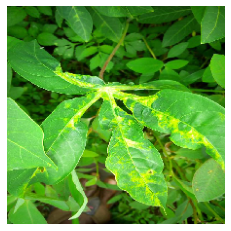

In [ ]:
img_path = os.path.join(WORK_DIR, "train_images", train_labels.image_id[20])
img = image.load_img(img_path, target_size = (TARGET_SIZE, TARGET_SIZE))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis = 0)
img_tensor /= 255.

plt.imshow(img_tensor[0])
plt.axis('off')
plt.show()

### This photo after augmentation

Found 1 validated image filenames belonging to 1 classes.


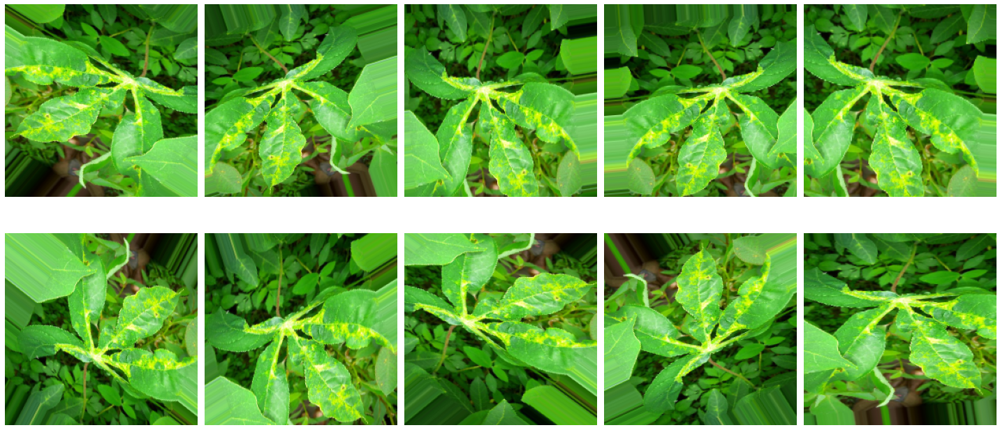

In [ ]:
generator = train_datagen.flow_from_dataframe(train_labels.iloc[20:21],
                         directory = os.path.join(WORK_DIR, "train_images"),
                         x_col = "image_id",
                         y_col = "label",
                         target_size = (TARGET_SIZE, TARGET_SIZE),
                         batch_size = BATCH_SIZE,
                         class_mode = "sparse")

aug_images = [generator[0][0][0]/255 for i in range(10)]
fig, axes = plt.subplots(2, 5, figsize = (20, 10))
axes = axes.flatten()
for img, ax in zip(aug_images, axes):
    ax.imshow(img)
    ax.axis('off')
plt.tight_layout()
plt.show()

# Modeling

In [ ]:
# Code for basic EfficientNetB0 CNN

# def create_model():
#     conv_base = EfficientNetB0(include_top = False, weights = 'imagenet',
#                                input_shape = (TARGET_SIZE, TARGET_SIZE, 3))
#     model = conv_base.output
#     model = layers.GlobalAveragePooling2D()(model)
#     model = layers.Dense(5, activation = "softmax")(model)
#     model = models.Model(conv_base.input, model)

#     model.compile(optimizer = Adam(lr = 0.001),
#                   loss = "sparse_categorical_crossentropy",
#                   metrics = ["acc"])
#     return model

# model = create_model()
# model.summary()

In [ ]:
# model.save('./basic_EfNetB0_imagenet_512.h5')

### Creating the CNN

In [ ]:
# def create_model():
#     conv_base = EfficientNetB0(include_top = False, weights = None,
#                                input_shape = (TARGET_SIZE, TARGET_SIZE, 3))
#     model = conv_base.output
#     model = layers.GlobalAveragePooling2D()(model)
#     model = layers.Dense(5, activation = "softmax")(model)
#     model = models.Model(conv_base.input, model)

#     model.compile(optimizer = Adam(lr = 0.001),
#                   loss = "sparse_categorical_crossentropy",
#                   metrics = ["acc"])
#     return model

In [ ]:
'''
Source: https://github.com/qubvel/residual_attention_network
'''

from keras.layers import BatchNormalization
from keras.layers import Conv2D
from keras.layers import UpSampling2D
from keras.layers import Activation
from keras.layers import MaxPool2D
from keras.layers import Add
from keras.layers import Multiply
from keras.layers import Lambda


# def residual_block(input, input_channels=None, output_channels=None, kernel_size=(3, 3), stride=1):
#     """
#     full pre-activation residual block
#     https://arxiv.org/pdf/1603.05027.pdf
#     """
#     if output_channels is None:
#         output_channels = input.get_shape()[-1]
#     if input_channels is None:
#         input_channels = output_channels // 4
#
#     strides = (stride, stride)
#
#     x = BatchNormalization()(input)
#     x = Activation('relu')(x)
#     x = Conv2D(input_channels, (1, 1))(x)
#
#     x = BatchNormalization()(x)
#     x = Activation('relu')(x)
#     x = Conv2D(input_channels, kernel_size, padding='same', strides=stride)(x)
#
#     x = BatchNormalization()(x)
#     x = Activation('relu')(x)
#     x = Conv2D(output_channels, (1, 1), padding='same')(x)
#
#     if input_channels != output_channels or stride != 1:
#         input = Conv2D(output_channels, (1, 1), padding='same', strides=strides)(input)
#
#     x = Add()([x, input])
#     return x



def residual_block(input, input_channels=None, output_channels=None, kernel_size=(3, 3), stride=1):
    if output_channels is None:
        output_channels = input.get_shape()[-1]
    if input_channels is None:
        input_channels = output_channels // 4

    strides = (stride, stride)

    x = Activation('relu')(input)
    x = BatchNormalization()(x)
    x = Conv2D(input_channels, (1, 1))(x)

    x = Activation('relu')(x)
    x = BatchNormalization()(x)
    x = Conv2D(input_channels, kernel_size, padding='same', strides=stride)(x)

    x = Activation('relu')(x)
    x = BatchNormalization()(x)
    x = Conv2D(output_channels, (1, 1), padding='same')(x)

    if input_channels != output_channels or stride != 1:
        input = Conv2D(output_channels, (1, 1), padding='same', strides=strides)(input)

    x = Add()([x, input])
    return x


def attention_block(input, input_channels=None, output_channels=None, encoder_depth=1):

    p = 1
    t = 2
    r = 1

    if input_channels is None:
        input_channels = input.get_shape()[-1]
    if output_channels is None:
        output_channels = input_channels

    # First Residual Block
    for i in range(p):
        input = residual_block(input)

    # Trunc Branch
    output_trunk = input
    for i in range(t):
        output_trunk = residual_block(output_trunk)


    # Soft Mask Branch
    ## encoder
    ### first down sampling
    output_soft_mask = MaxPool2D(padding='same')(input)  # 32x32
    for i in range(r):
        output_soft_mask = residual_block(output_soft_mask)

    skip_connections = []
    for i in range(encoder_depth - 1):

        ## skip connections
        output_skip_connection = residual_block(output_soft_mask)
        skip_connections.append(output_skip_connection)
        # print ('skip shape:', output_skip_connection.get_shape())

        ## down sampling
        output_soft_mask = MaxPool2D(padding='same')(output_soft_mask)
        for _ in range(r):
            output_soft_mask = residual_block(output_soft_mask)


    ## decoder
    skip_connections = list(reversed(skip_connections))
    for i in range(encoder_depth - 1):
        ## upsampling666
        for _ in range(r):
            output_soft_mask = residual_block(output_soft_mask)
        output_soft_mask = UpSampling2D()(output_soft_mask)
        ## skip connections
        output_soft_mask = Add()([output_soft_mask, skip_connections[i]])

    ### last upsampling
    for i in range(r):
        output_soft_mask = residual_block(output_soft_mask)
    output_soft_mask = UpSampling2D()(output_soft_mask)

    ## Output
    output_soft_mask = Conv2D(input_channels, (1, 1))(output_soft_mask)
    output_soft_mask = Conv2D(input_channels, (1, 1))(output_soft_mask)
    output_soft_mask = Activation('sigmoid')(output_soft_mask)

    # Attention: (1 + output_soft_mask) * output_trunk
    output = Lambda(lambda x: x + 1)(output_soft_mask)
    output = Multiply()([output, output_trunk])  #

    # Last Residual Block
    for i in range(p):
        output = residual_block(output)

    return output

In [ ]:
from keras.layers import Input
from keras.layers import Conv2D
from keras.layers import MaxPool2D
from keras.layers import Dense
from keras.layers import AveragePooling2D
from keras.layers import Flatten
from keras.layers import Activation
from keras.layers import BatchNormalization
from keras.layers import Dropout
from keras.models import Model
from keras.regularizers import l2




def AttentionResNet92(shape=(224, 224, 3), n_channels=64, n_classes=100,
                      dropout=0, regularization=0.01):
    """
    Attention-92 ResNet
    https://arxiv.org/abs/1704.06904
    """
    regularizer = l2(regularization)

    input_ = Input(shape=shape)
    x = Conv2D(n_channels, (7, 7), strides=(2, 2), padding='same')(input_) # 112x112
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPool2D(pool_size=(3, 3), strides=(2, 2), padding='same')(x)  # 56x56

    x = residual_block(x, output_channels=n_channels * 4)  # 56x56
    x = attention_block(x, encoder_depth=3)  # bottleneck 7x7

    x = residual_block(x, output_channels=n_channels * 8, stride=2)  # 28x28
    x = attention_block(x, encoder_depth=2)  # bottleneck 7x7
    x = attention_block(x, encoder_depth=2)  # bottleneck 7x7

    x = residual_block(x, output_channels=n_channels * 16, stride=2)  # 14x14
    x = attention_block(x, encoder_depth=1)  # bottleneck 7x7
    x = attention_block(x, encoder_depth=1)  # bottleneck 7x7
    x = attention_block(x, encoder_depth=1)  # bottleneck 7x7

    x = residual_block(x, output_channels=n_channels * 32, stride=2)  # 7x7
    x = residual_block(x, output_channels=n_channels * 32)
    x = residual_block(x, output_channels=n_channels * 32)

    pool_size = (x.get_shape()[1], x.get_shape()[2])
    x = AveragePooling2D(pool_size=pool_size, strides=(1, 1))(x)
    x = Flatten()(x)
    if dropout:
        x = Dropout(dropout)(x)
    output = Dense(n_classes, kernel_regularizer=regularizer, activation='softmax')(x)

    model = Model(input_, output)
    return model


def AttentionResNet56(shape=(224, 224, 3), n_channels=64, n_classes=100,
                      dropout=0, regularization=0.01):
    """
    Attention-56 ResNet
    https://arxiv.org/abs/1704.06904
    """

    regularizer = l2(regularization)

    input_ = Input(shape=shape)
    x = Conv2D(n_channels, (7, 7), strides=(2, 2), padding='same')(input_) # 112x112
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPool2D(pool_size=(3, 3), strides=(2, 2), padding='same')(x)  # 56x56

    x = residual_block(x, output_channels=n_channels * 4)  # 56x56
    x = attention_block(x, encoder_depth=3)  # bottleneck 7x7

    x = residual_block(x, output_channels=n_channels * 8, stride=2)  # 28x28
    x = attention_block(x, encoder_depth=2)  # bottleneck 7x7

    x = residual_block(x, output_channels=n_channels * 16, stride=2)  # 14x14
    x = attention_block(x, encoder_depth=1)  # bottleneck 7x7

    x = residual_block(x, output_channels=n_channels * 32, stride=2)  # 7x7
    x = residual_block(x, output_channels=n_channels * 32)
    x = residual_block(x, output_channels=n_channels * 32)

    pool_size = (x.get_shape()[1], x.get_shape()[2])
    x = AveragePooling2D(pool_size=pool_size, strides=(1, 1))(x)
    x = Flatten()(x)
    if dropout:
        x = Dropout(dropout)(x)
    output = Dense(n_classes, kernel_regularizer=regularizer, activation='softmax')(x)

    model = Model(input_, output)
    return model


def AttentionResNetCifar10(shape=(32, 32, 3), n_channels=32, n_classes=10):
    """
    Attention-56 ResNet for Cifar10 Dataset
    https://arxiv.org/abs/1704.06904
    """
    input_ = Input(shape=shape)
    x = Conv2D(n_channels, (5, 5), padding='same')(input_)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPool2D(pool_size=(2, 2))(x)  # 16x16

    x = residual_block(x, input_channels=32, output_channels=128)
    x = attention_block(x, encoder_depth=2)

    x = residual_block(x, input_channels=128, output_channels=256, stride=2)  # 8x8
    x = attention_block(x, encoder_depth=1)

    x = residual_block(x, input_channels=256, output_channels=512, stride=2)  # 4x4
    x = attention_block(x, encoder_depth=1)

    x = residual_block(x, input_channels=512, output_channels=1024)
    x = residual_block(x, input_channels=1024, output_channels=1024)
    x = residual_block(x, input_channels=1024, output_channels=1024)

    x = AveragePooling2D(pool_size=(4, 4), strides=(1, 1))(x)  # 1x1
    x = Flatten()(x)
    output = Dense(n_classes, activation='softmax')(x)

    model = Model(input_, output)
    return model

In [ ]:
NUM_CLASSES = 5
HEIGHT = 224
WIDTH = 224
CHANNEL = 3
model = AttentionResNet92(shape=(HEIGHT, WIDTH, CHANNEL), n_channels=CHANNEL, n_classes=5)

In [ ]:
from tensorflow import keras
from tensorflow.keras import layers
model.compile(keras.optimizers.Adam(lr=0.0001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [ ]:
#model = create_model()
model.summary()

Model: "functional_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_229 (Conv2D)             (None, 112, 112, 3)  444         input_2[0][0]                    
__________________________________________________________________________________________________
batch_normalization_163 (BatchN (None, 112, 112, 3)  12          conv2d_229[0][0]                 
__________________________________________________________________________________________________
activation_169 (Activation)     (None, 112, 112, 3)  0           batch_normalization_163[0][0]    
_______________________________________________________________________________________

Total params: 198,845
Trainable params: 193,589
Non-trainable params: 5,256
__________________________________________________________________________________________________


In [ ]:
print('Our Attention CNN has %d layers' %len(model.layers))

Our Attention CNN has 656 layers


### Loading weights

In [ ]:
#model.load_weights('../input/cassava-leaf-disease-models/basic_EfNetB0_imagenet_512.h5')

### Training

In [ ]:

early_stop = EarlyStopping(monitor = 'val_loss', min_delta = 0.001, 
                           patience = 10, verbose = 1,
                           restore_best_weights = True)
reduce_lr = ReduceLROnPlateau(monitor = 'val_loss', factor = 0.3, 
                              patience = 15, min_delta = 0.001, 
                              verbose = 1)


history = model.fit(
    train_generator,
    steps_per_epoch = STEPS_PER_EPOCH,
    epochs = EPOCHS,
    validation_data = validation_generator,
    validation_steps = VALIDATION_STEPS,
    callbacks = [early_stop, reduce_lr]
)

Epoch 1/200
2140/2139 [==============================] - 518s 242ms/step - loss: 1.2191 - accuracy: 0.6176 - val_loss: 1.4983 - val_accuracy: 0.5153
Epoch 2/200
2140/2139 [==============================] - 460s 215ms/step - loss: 1.1733 - accuracy: 0.6234 - val_loss: 1.2029 - val_accuracy: 0.6270
Epoch 3/200
2140/2139 [==============================] - 457s 213ms/step - loss: 1.1455 - accuracy: 0.6273 - val_loss: 1.1326 - val_accuracy: 0.6322
Epoch 4/200
2140/2139 [==============================] - 457s 213ms/step - loss: 1.1213 - accuracy: 0.6309 - val_loss: 1.1605 - val_accuracy: 0.6249
Epoch 5/200
2140/2139 [==============================] - 457s 213ms/step - loss: 1.0992 - accuracy: 0.6309 - val_loss: 1.1381 - val_accuracy: 0.6312
Epoch 6/200
2140/2139 [==============================] - 456s 213ms/step - loss: 1.0818 - accuracy: 0.6326 - val_loss: 1.0534 - val_accuracy: 0.6380
Epoch 7/200
2140/2139 [==============================] - 463s 216ms/step - loss: 1.0649 - accuracy: 0.6366

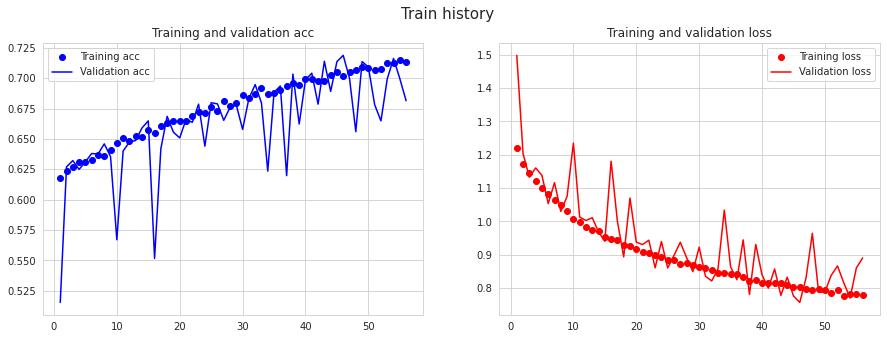

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
sns.set_style("white")
plt.suptitle('Train history', size = 15)

ax1.plot(epochs, acc, "bo", label = "Training acc")
ax1.plot(epochs, val_acc, "b", label = "Validation acc")
ax1.set_title("Training and validation acc")
ax1.legend()

ax2.plot(epochs, loss, "bo", label = "Training loss", color = 'red')
ax2.plot(epochs, val_loss, "b", label = "Validation loss", color = 'red')
ax2.set_title("Training and validation loss")
ax2.legend()

plt.show()

In [ ]:
model.save('./EffNetB0_512_8.h5')

# Visualization of CNN intermediate activations

In [ ]:
def activation_layer_vis(img, activation_layer = 0, layers = 10):
    layer_outputs = [layer.output for layer in model.layers[:layers]]
    activation_model = models.Model(inputs = model.input, outputs = layer_outputs)
    activations = activation_model.predict(img)
    
    rows = int(activations[activation_layer].shape[3] / 3)
    cols = int(activations[activation_layer].shape[3] / rows)
    fig, axes = plt.subplots(rows, cols, figsize = (15, 15 * cols))
    axes = axes.flatten()
    
    for i, ax in zip(range(activations[activation_layer].shape[3]), axes):
        ax.matshow(activations[activation_layer][0, :, :, i], cmap = 'viridis')
        ax.axis('off')
    plt.tight_layout()
    plt.show()

### Visualization of the first layer

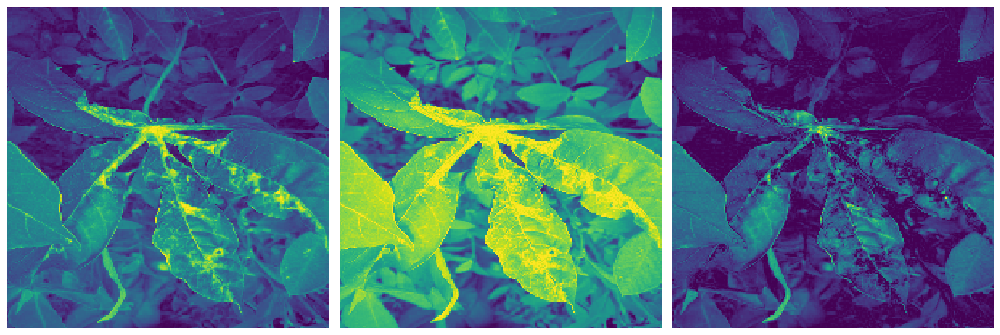

In [ ]:
activation_layer_vis(img_tensor, 0)

In [ ]:
def all_activations_vis(img, layers = 5):
    layer_outputs = [layer.output for layer in model.layers[layers:]]
    activation_model = models.Model(inputs = model.input, outputs = layer_outputs)
    activations = activation_model.predict(img)
    
    layer_names = []
    for layer in model.layers[layers:]: 
        layer_names.append(layer.name) 

    images_per_row = 3
    for layer_name, layer_activation in zip(layer_names, activations): 
        n_features = layer_activation.shape[-1] 

        size = layer_activation.shape[1] 

        n_cols = n_features // images_per_row 
        display_grid = np.zeros((size * n_cols, images_per_row * size)) 

        for col in range(n_cols): 
            for row in range(images_per_row): 
                channel_image = layer_activation[0, :, :, col * images_per_row + row] 
                channel_image -= channel_image.mean() 
                channel_image /= channel_image.std() 
                channel_image *= 64 
                channel_image += 128 
                channel_image = np.clip(channel_image, 0, 255).astype('uint8') 
                display_grid[col * size : (col + 1) * size, 
                             row * size : (row + 1) * size] = channel_image 
        scale = 1. / size 
        plt.figure(figsize=(scale * 5 * display_grid.shape[1], 
                            scale * 5 * display_grid.shape[0])) 
        plt.title(layer_name) 
        plt.grid(False)
        plt.axis('off')
        plt.imshow(display_grid, aspect = 'auto', cmap = 'viridis')

### Visualization of the first 5 layers

IndexError: too many indices for array

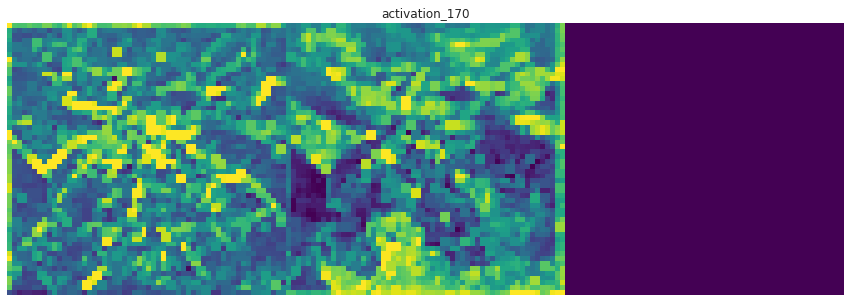

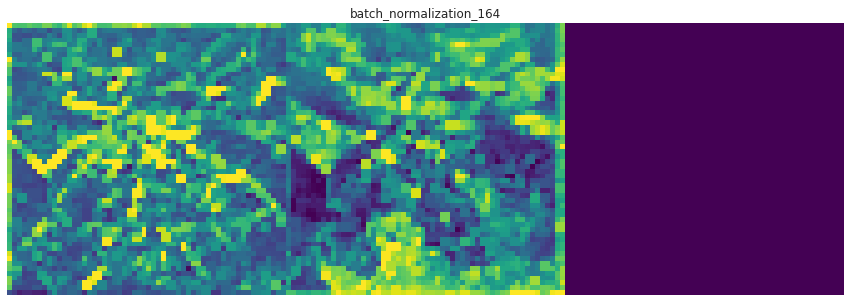

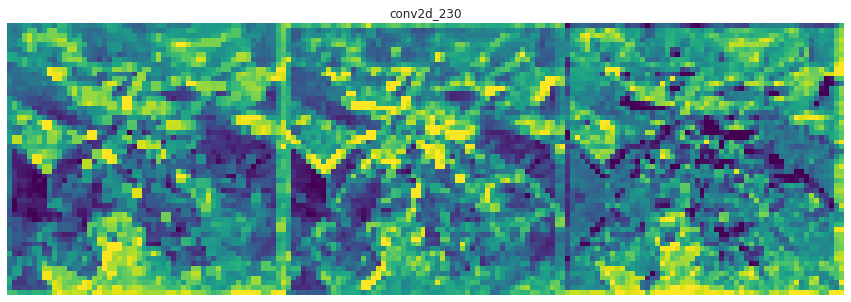

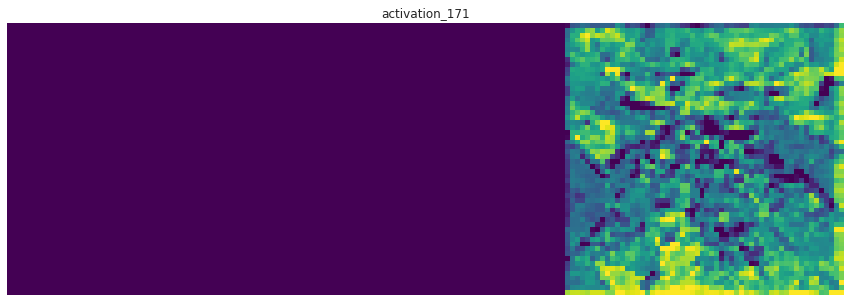

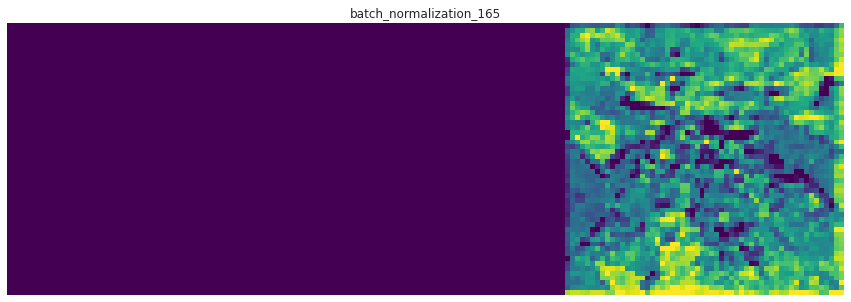

...

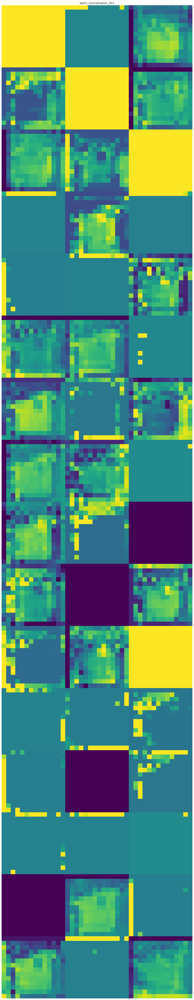

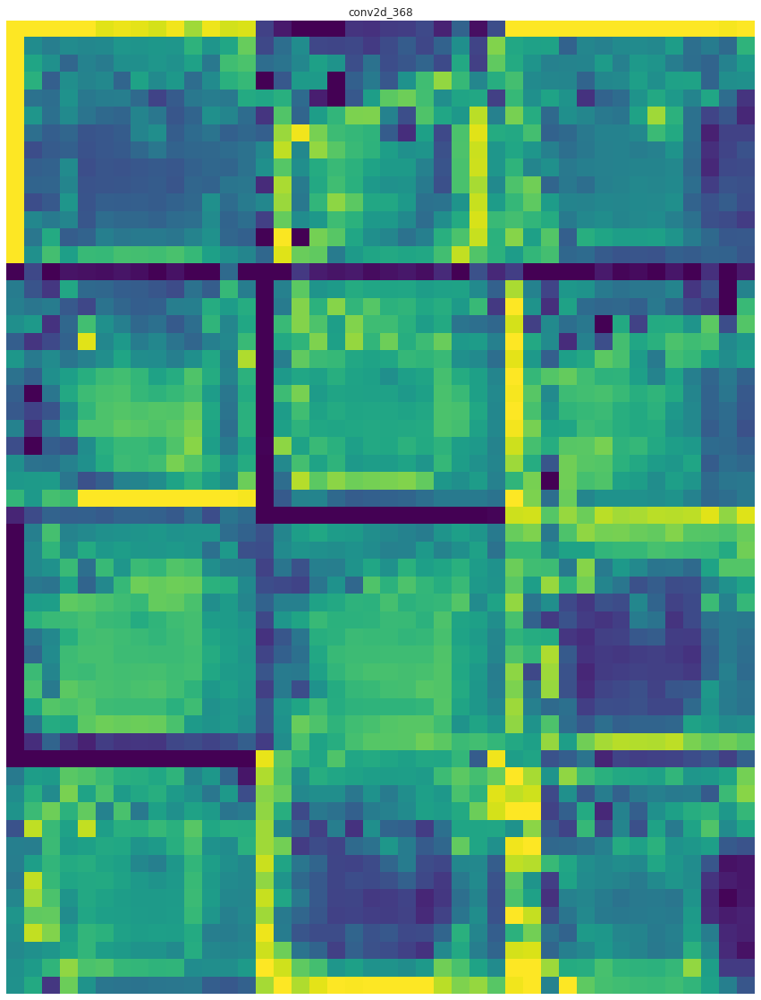

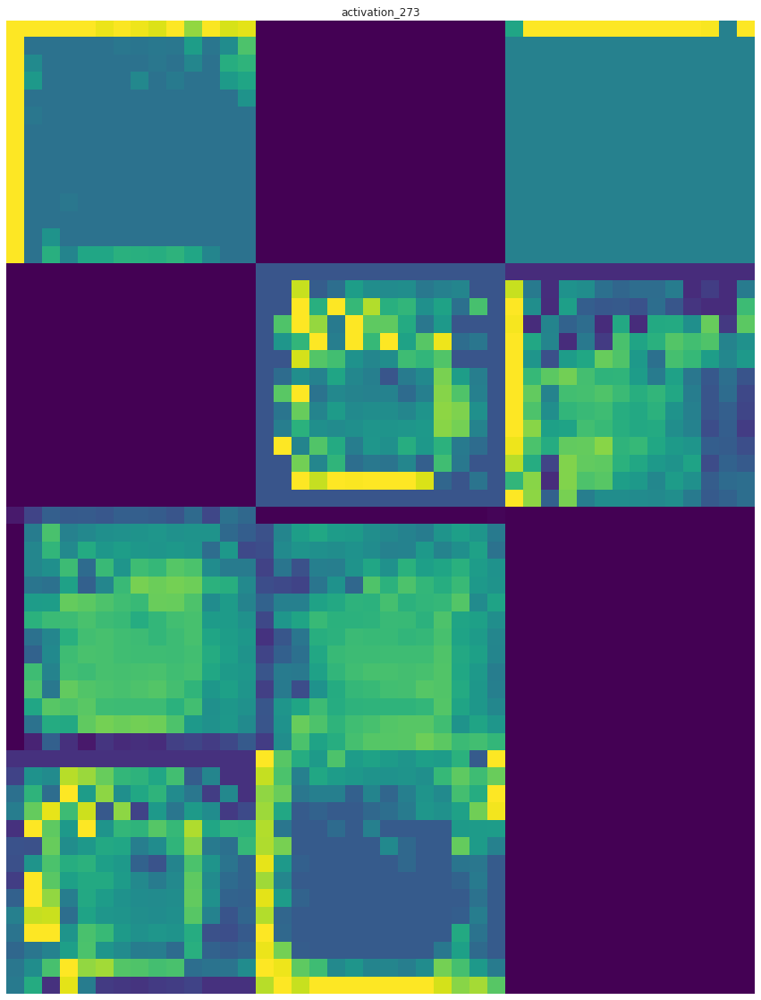

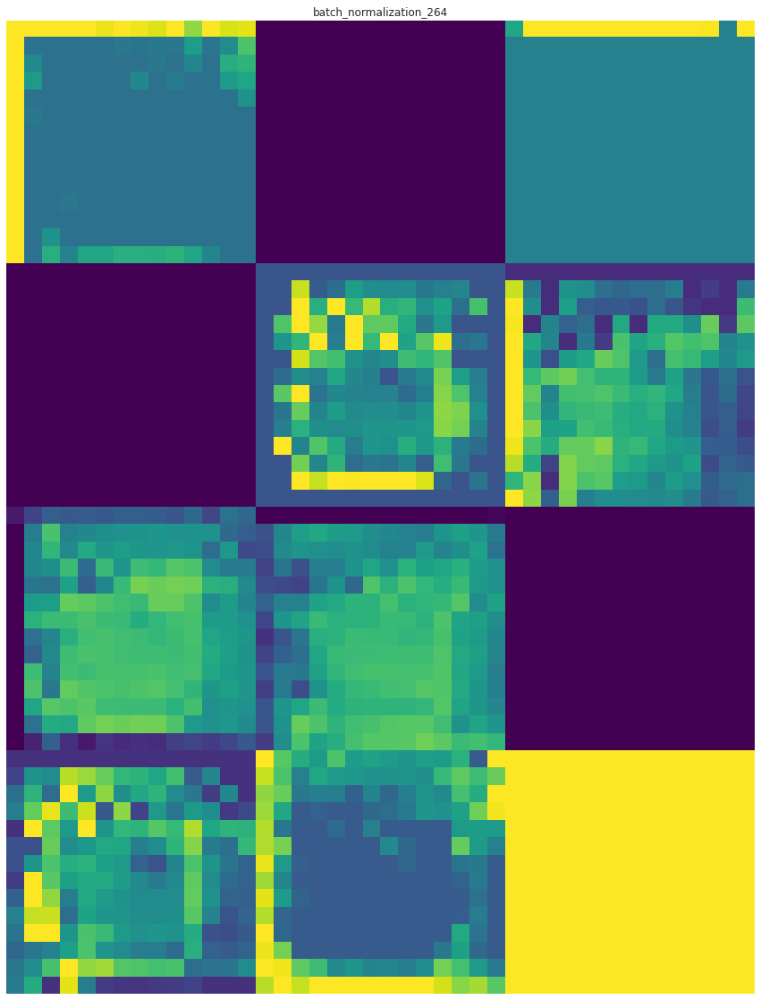

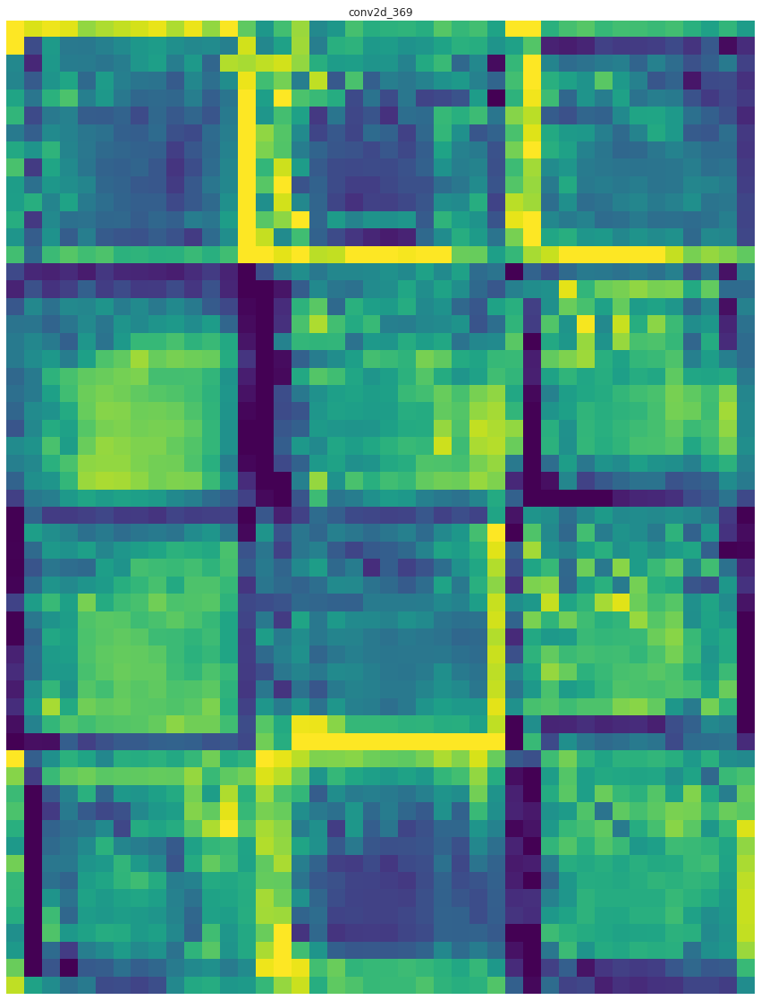

In [ ]:
all_activations_vis(img_tensor, 5)

Visualization of intermediate activations gives a rough step-by-step understanding of how CNN works.

In [ ]:
model.load_weights('./EffNetB0_512_8.h5')

# Prediction

In [ ]:
ss = pd.read_csv(os.path.join(WORK_DIR, "sample_submission.csv"))
ss

,image_id,label
0,2216849948.jpg,4


In [ ]:
preds = []

for image_id in ss.image_id:
    image = Image.open(os.path.join(WORK_DIR,  "test_images", image_id))
    image = image.resize((TARGET_SIZE, TARGET_SIZE))
    image = np.expand_dims(image, axis = 0)
    preds.append(np.argmax(model.predict(image)))

ss['label'] = preds
ss

,image_id,label
0,2216849948.jpg,2


In [ ]:
ss.to_csv('submission.csv', index = False)

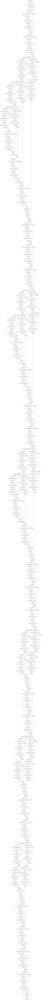

In [ ]:
keras.utils.plot_model(model)

## WORK IN PROGRESS...